# Проектная работа

# **Рынок заведений общественного питания Москвы**

Цель работы - исследование рынка заведений обшественного питания г. Москва, поиск особенностей для выбора подходящего места под новый проект для инвестиционного фонда.

## 1. Общая информация

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


В качестве исходных данных для анализа используется датасет с заведениями общественного питания г. Москва, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес по состоянию на лето 2022 г.

In [6]:
data = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/moscow_places.csv")

In [7]:
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [8]:
data.tail()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
8401,Суши Мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,0,86.0
8402,Миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,0,150.0
8403,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,1,150.0
8405,Kebab Time,кафе,"Москва, Россошанский проезд, 6",Южный административный округ,"ежедневно, круглосуточно",55.598229,37.604702,3.9,NaN,NaN,NaN,NaN,0,12.0


Размер данных

In [9]:
data.shape

(8406, 14)

В датасете представлена информация по 8406 заведениям.

Названия столбцов

In [10]:
data.columns

Index(['name', 'category', 'address', 'district', 'hours', 'lat', 'lng',
       'rating', 'price', 'avg_bill', 'middle_avg_bill', 'middle_coffee_cup',
       'chain', 'seats'],
      dtype='object')

Для заведений приведена информация по 14 признакам:
* `name` - название заведения;
* `category` - категория заведения;
* `address` - адрес заведения;
* `district` - административный район;
* `hours` - информация о днях и часах работы;
* `lat`, `lng` - широта и долгота географической точки заведения;
* `rating` - рейтинг заведения по оценкам пользователей;
* `price` - категория цен в заведении;
* `avg_bill` - средняя стоимость заказа, в т.ч.:
>* `middle_avg_bill` - оценка среднего чека;
>* `middle_coffee_cup` - оценка одной чашки капучино;
* `chain` - не_сетевое(0)/сетевое(1) заведение;
* `seats` - количество посадочных мест.

Общая информация по датафрейму и всем признакам

In [11]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Типы признаков - `object`, `float64`, `int64`. Видим, что семь признаков имеют тип `object` и семь числовых признаков.

Основные статистические характеристики данных по числовым признакам (число непропущенных значений, среднее, стандартное отклонение, диапазон, медиана, 0.25 и 0.75 квартили)

In [12]:
data[["rating", "seats"]].describe()

,rating,seats
count,8406.000000,4795.000000
mean,4.229895,108.421689
std,0.470348,122.833396
min,1.000000,0.000000
25%,4.100000,40.000000
50%,4.300000,75.000000
75%,4.400000,140.000000
max,5.000000,1288.000000


Статистика по нечисловым признакам

In [13]:
data[['name', 'category', 'district', 'hours', 'price', 'avg_bill']].describe(include=["object"])

,name,category,district,hours,price,avg_bill
count,8406,8406,8406,7870,3315,3816
unique,5614,8,9,1307,4,897
top,Кафе,кафе,Центральный административный округ,"ежедневно, 10:00–22:00",средние,Средний счёт:1000–1500 ₽
freq,189,2378,2242,759,2117,241


## 2. Предобработка данных

### **Дубликаты**

Проверим, есть ли в датасете повторяющиеся строки.

In [14]:
data = data.drop_duplicates()

In [15]:
data.shape

(8406, 14)

Видим, что размер не изменился, дубликатов строк в данных нет.

### **Пропуски**

Посмотрим на пропуски в данных.

In [16]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 985.1+ KB


Пропуски имеются в столбцах `hours`, `price`, `avg_bill`, а также `middle_avg_bill` и `middle_coffee_cup` (по условию данные столбцы заполняются только для значений из столбца `avg_bill`) и `seats`.

Количество пропусков в столбце `hours` - 536



In [17]:
data[['name', 'category', 'hours']][(data['hours'].isnull())]

,name,category,hours
38,Ижора,булочная,NaN
40,Кафе,кафе,NaN
44,Кафетерий,кафе,NaN
56,Рыба из тандыра,быстрое питание,NaN
108,Кафе,"бар,паб",NaN
...,...,...,...
8236,1у,кафе,NaN
8375,Улица Гурьянова 55,кафе,NaN
8378,Восточно-грузинская кухня,быстрое питание,NaN
8381,Аэлита,кафе,NaN


В т.ч. больше всего пропусков в столбце `hours` для категории `кафе` - 375

In [18]:
data[['category', 'hours']][(data['hours'].isnull())].groupby(["category"])["category"].count().sort_values(ascending=False)

category
кафе               375
ресторан            74
быстрое питание     33
бар,паб             18
кофейня             15
столовая             9
булочная             7
пиццерия             5
Name: category, dtype: int64

При необходимости, информацию о времени работы заведений, можно восполнить путем сбора дополнительных данных из открытых источников, но это потребует дополнительных временных затрат. Также значения можно заменить медианой по соответствующим категориям, наример, для категории `кафе` - "ежедневно, 10:00–22:00"

In [19]:
data[['category', 'hours']].dropna().describe()

,category,hours
count,7870,7870
unique,8,1307
top,кафе,"ежедневно, 10:00–22:00"
freq,2003,759


Для дополнения данных в столбце `price` можно воспользоваться информацией из столбца `avg_bill`, при наличии. Остальные данные можно заполнить медианой в соответствующей категории, учитывающей район города.

In [20]:
data[['category', 'price', 'avg_bill', 'middle_avg_bill',	'middle_coffee_cup']]

,category,price,avg_bill,middle_avg_bill,middle_coffee_cup
0,кафе,NaN,NaN,NaN,NaN
1,ресторан,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN
2,кафе,средние,Средний счёт:от 1000 ₽,1000.0,NaN
3,кофейня,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0
4,пиццерия,средние,Средний счёт:400–600 ₽,500.0,NaN
...,...,...,...,...,...
8401,кафе,NaN,NaN,NaN,NaN
8402,кафе,NaN,NaN,NaN,NaN
8403,кафе,NaN,Средний счёт:от 150 ₽,150.0,NaN
8404,кафе,NaN,NaN,NaN,NaN


Оставим только строки, которые содержат информацию о ценах (таких 4058).

In [21]:
price_data = data[['category', 'price', 'avg_bill', 'middle_avg_bill',	'middle_coffee_cup']].dropna(subset=['price', 'avg_bill', 'middle_avg_bill',	'middle_coffee_cup'], how='all')
price_data

,category,price,avg_bill,middle_avg_bill,middle_coffee_cup
1,ресторан,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN
2,кафе,средние,Средний счёт:от 1000 ₽,1000.0,NaN
3,кофейня,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0
4,пиццерия,средние,Средний счёт:400–600 ₽,500.0,NaN
5,пиццерия,средние,NaN,NaN,NaN
...,...,...,...,...,...
8387,"бар,паб",средние,Цена бокала пива:от 140 ₽,NaN,NaN
8396,ресторан,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN
8397,пиццерия,средние,NaN,NaN,NaN
8399,булочная,NaN,Средний счёт:50–250 ₽,150.0,NaN


Посмотрим на статистические значения среднего чека (`middle_avg_bill`) в категории ресторан. Обращаем внимание, что границы цен (min, max) для категорий в столбце `price` пересекаются. 

In [22]:
agg_functions = {"middle_avg_bill": ["mean", "median", "min", "max"]}
price_data[['price', 'middle_avg_bill']][price_data["category"] == 'ресторан'].groupby(["price"]).agg(agg_functions).sort_values(('middle_avg_bill', 'mean'), ascending=False)

middle_avg_bill                         
                         mean  median     min      max
price                                                 
высокие           2646.183206  2250.0  1000.0  35000.0
выше среднего     1359.325397  1250.0   750.0   2250.0
средние            709.348449   700.0   200.0   2150.0
низкие             324.761905   300.0   120.0    575.0

Выведем информацию о пропущенных значениях в столбце `price` для категории "ресторан". Используя значения в столбце `avg_bill` и расчетные данные из таблицы выше можно заполнить пропущенные значения в столбце `price`, используя минимальную близость до медианы соответсвующей категории цен.

In [23]:
price_data[(price_data["category"] == 'ресторан') & price_data["price"].isnull()]

,category,price,avg_bill,middle_avg_bill,middle_coffee_cup
107,ресторан,NaN,Средний счёт:269 ₽,269.0,NaN
157,ресторан,NaN,Средний счёт:1000–1500 ₽,1250.0,NaN
311,ресторан,NaN,Средний счёт:900–1100 ₽,1000.0,NaN
328,ресторан,NaN,Средний счёт:1000–1500 ₽,1250.0,NaN
396,ресторан,NaN,Средний счёт:200–400 ₽,300.0,NaN
...,...,...,...,...,...
7813,ресторан,NaN,Средний счёт:800–1000 ₽,900.0,NaN
7890,ресторан,NaN,Средний счёт:2000–2500 ₽,2250.0,NaN
7891,ресторан,NaN,Средний счёт:1000–1500 ₽,1250.0,NaN
8115,ресторан,NaN,Средний счёт:300–350 ₽,325.0,NaN


Выполним аналогичный расчет среднего чека (`middle_avg_bill`) для кафе

In [24]:
agg_functions = {"middle_avg_bill": ["mean", "median", "min", "max"]}
price_data[['price', 'middle_avg_bill']][price_data["category"] == 'кафе'].groupby(["price"]).agg(agg_functions).sort_values(('middle_avg_bill', 'mean'), ascending=False)

middle_avg_bill                        
                         mean  median     min     max
price                                                
высокие           2133.333333  2000.0   950.0  4500.0
выше среднего     1302.739726  1250.0  1100.0  1700.0
средние            585.574786   500.0   200.0  1750.0
низкие             207.692308   150.0   100.0   600.0

Выведем информацию о пропущенных значениях в столбце `price` для категории "кафе". Используя значения в столбце `avg_bill` и расчетные данные из таблицы выше можно заполнить пропущенные значения в столбце `price`, используя минимальную близость до медианы соответсвующей категории цен.

In [25]:
price_data[(price_data["category"] == 'кафе') & price_data["price"].isnull()]

,category,price,avg_bill,middle_avg_bill,middle_coffee_cup
113,кафе,NaN,Средний счёт:700–800 ₽,750.0,NaN
124,кафе,NaN,Средний счёт:от 200 ₽,200.0,NaN
145,кафе,NaN,Средний счёт:250–300 ₽,275.0,NaN
191,кафе,NaN,Средний счёт:500–1000 ₽,750.0,NaN
246,кафе,NaN,Средний счёт:100–200 ₽,150.0,NaN
...,...,...,...,...,...
8205,кафе,NaN,Средний счёт:270 ₽,270.0,NaN
8216,кафе,NaN,Средний счёт:300–1000 ₽,650.0,NaN
8247,кафе,NaN,Средний счёт:200–500 ₽,350.0,NaN
8347,кафе,NaN,Средний счёт:300–400 ₽,350.0,NaN


Аналогичные операции можно провести для заполнения значений в столбце `price` для остальных категорий заведений.

Используя медианные значения для категорий цен по соответствующей категории заведений можно заполнить недостающие значения в стоблце `middle_avg_bill`. 

Для пропусков в столбце `seets` также можно использовать медианные значения по соответствующим категориям заведений и соответствующей ценовой категории.

**Дальнейший анализ выполняется по имеющимся данным.**



### **Столбец `street`**

Выделим из столбца `address` информацию об улицах. Создадим новыц столбец `street`. 

In [26]:
data['street'] = data['address'].map(lambda x: x.split(",")[1])

Проверяем

In [27]:
data[["address","street"]]

,address,street
0,"Москва, улица Дыбенко, 7/1",улица Дыбенко
1,"Москва, улица Дыбенко, 36, корп. 1",улица Дыбенко
2,"Москва, Клязьминская улица, 15",Клязьминская улица
3,"Москва, улица Маршала Федоренко, 12",улица Маршала Федоренко
4,"Москва, Правобережная улица, 1Б",Правобережная улица
...,...,...
8401,"Москва, Профсоюзная улица, 56",Профсоюзная улица
8402,"Москва, Пролетарский проспект, 19, корп. 1",Пролетарский проспект
8403,"Москва, Люблинская улица, 112А, стр. 1",Люблинская улица
8404,"Москва, Люблинская улица, 112А, стр. 1",Люблинская улица


Улица на которой больше всего заведений - проспект Мира

In [28]:
data["street"].value_counts()

 проспект Мира                 184
 Профсоюзная улица             122
 проспект Вернадского          108
 Ленинский проспект            107
 Ленинградский проспект         95
                              ... 
 улица Маршала Соколовского      1
 Малый Казённый переулок         1
 улица Максимова                 1
 Басманный тупик                 1
 Чонгарский бульвар              1
Name: street, Length: 1448, dtype: int64

### **Столбец `is_24/7`**

Создадим столбец `is_24/7`, с обозначением True - если заведение работает ежедневно и круглосуточно (24/7) и False - в противоположном случае.

In [29]:
data['is_24/7'] = data['hours'].dropna().map(lambda x: 'ежедневно' and 'круглосуточно' in x)

Проверяем

In [30]:
data[["hours","is_24/7"]]

,hours,is_24/7
0,"ежедневно, 10:00–22:00",False
1,"ежедневно, 10:00–22:00",False
2,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",False
3,"ежедневно, 09:00–22:00",False
4,"ежедневно, 10:00–22:00",False
...,...,...
8401,"ежедневно, 09:00–02:00",False
8402,"ежедневно, 08:00–22:00",False
8403,"ежедневно, круглосуточно",True
8404,"ежедневно, круглосуточно",True


Количество заведений, работающих в режиме 24/7 - 772

In [31]:
data["is_24/7"].value_counts()

False    7098
True      772
Name: is_24/7, dtype: int64

## 3. Анализ Данных

### **Категории заведений**

Рассмотрим категории заведений, представленных в датасете в отсортированном по убыванию их количества порядке.

In [32]:
data["category"].value_counts()

кафе               2378
ресторан           2043
кофейня            1413
бар,паб             765
пиццерия            633
быстрое питание     603
столовая            315
булочная            256
Name: category, dtype: int64

Построим визуализацию с указанием процентного соотношения.

<AxesSubplot:title={'center':'Категории заведений'}, ylabel='category'>

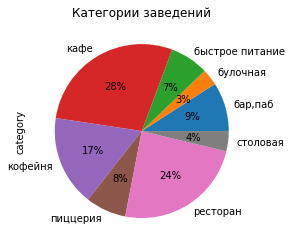

In [33]:
data.groupby(['category'])['category'].count().plot(kind='pie', y='count', autopct='%1.0f%%', title='Категории заведений')

**Наибольшее число заведений общественного питания г. Москва - кафе (2378, 28%), далее идут рестораны (2043, 24%) и кофейни (1413, 17%).**

### **Посадочные места**

Проанализируем количество посадочных мест по категориям заведений.

In [34]:
data.groupby(['category'])['seats'].sum().sort_values(ascending=False)

category
ресторан           154869.0
кафе               118770.0
кофейня             83511.0
бар,паб             58281.0
пиццерия            40350.0
быстрое питание     34513.0
столовая            16359.0
булочная            13229.0
Name: seats, dtype: float64

Построим визуализацию с указанием процентного соотношения.

<AxesSubplot:title={'center':'Посадочные места'}, ylabel='seats'>

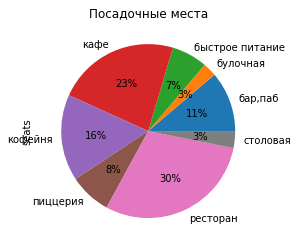

In [35]:
data.groupby(['category'])['seats'].sum().plot(kind='pie', y='count', autopct='%1.0f%%', title='Посадочные места')

**Наибольшим количеством посадочных мест располагают рестораны (154869, 30%), далее идут кафе (118770, 23%) и кофейни (83511, 16%). При этом стоит обратить внимание на то, что информация о количестве посадочных мест указана только для 4795 (57%) заведений из 8406 (100%)**.

### **Сетевые заведения**

Рассмотрим соотношение сетевых и несетевых заведений, представленных в датасете. Соответственно:
* '0' - заведение не является сетевым,
* '1' - заведение является сетевым. 

In [36]:
data.groupby(['chain'])['chain'].count().sort_values(ascending=False)

chain
0    5201
1    3205
Name: chain, dtype: int64

Визуализируем информацию

<AxesSubplot:title={'center':'Сетевое заведение (1) или нет (0)'}, ylabel='chain'>

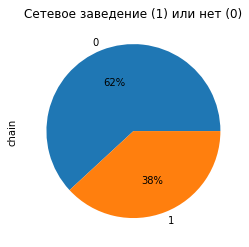

In [37]:
data.groupby(['chain'])['chain'].count().plot(kind='pie', y='count', autopct='%1.0f%%', title='Сетевое заведение (1) или нет (0)')

**Большинство заведений, представленных в датасете не является сетевыми (5201, 62%), сетевых 3205 или 38%.**

Отдельно рассмотрим сетевые заведения.

In [38]:
data[data['chain'] == 1].groupby(['category'])['category'].count().sort_values(ascending=False)

category
кафе               779
ресторан           730
кофейня            720
пиццерия           330
быстрое питание    232
бар,паб            169
булочная           157
столовая            88
Name: category, dtype: int64

Визуализируем информацию

<AxesSubplot:title={'center':'Категории сетевых заведений'}, ylabel='category'>

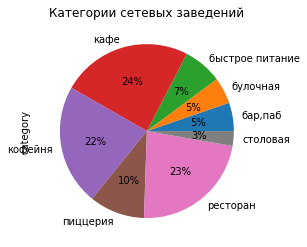

In [39]:
data[data['chain'] == 1].groupby(['category'])['category'].count().plot(kind='pie', y='count', autopct='%1.0f%%', title='Категории сетевых заведений')

**Наибольшее количество в представленных сетевых заведениях - кафе (779, 24%), далее рестораны (730, 23%) и кофейни (720, 22%).**

### **Топ-15 сетевых заведений**

Найдем топ-15 популярных сетей (по количеству заведений в регионе) и выведем их категорию.

In [40]:
data[data['chain'] == 1].groupby(['name', 'category'])['name'].count().sort_values(ascending=False).head(15)

name                                 category
Шоколадница                          кофейня     119
Домино'с Пицца                       пиццерия     76
Додо Пицца                           пиццерия     74
One Price Coffee                     кофейня      71
Яндекс Лавка                         ресторан     69
Cofix                                кофейня      65
Prime                                ресторан     49
КОФЕПОРТ                             кофейня      42
Кулинарная лавка братьев Караваевых  кафе         39
Теремок                              ресторан     36
CofeFest                             кофейня      31
Чайхана                              кафе         26
Буханка                              булочная     25
Drive Café                           кафе         24
Кофемания                            кофейня      22
Name: name, dtype: int64

Визуализируем полученные результаты, для наглядности заведения в одной категории (столбец `category`) обозначены одинаковым цветом.

<AxesSubplot:title={'center':'Топ-15 популярных сетей по количеству заведений'}, ylabel='name,category'>

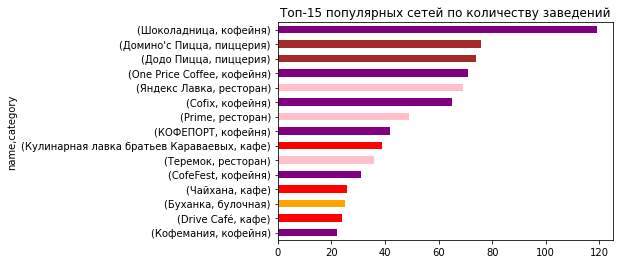

In [41]:
top_15_chain = data[data['chain'] == 1].groupby(['name', 'category'])['name'].count().sort_values(ascending=False).head(15)
colors_dict = {'кофейня': 'purple', 'пиццерия': 'brown', 'ресторан': 'pink', 'кафе': 'red', 'булочная': 'orange'}
colors = [colors_dict[x] for x in [x[1] for x in top_15_chain.index]]
top_15_chain.sort_values(ascending=True).head(15).plot(kind='barh', y='count', color=colors[::-1], title='Топ-15 популярных сетей по количеству заведений')

**Самым популярным сетевым заведением в г. Москва является кофейня Шоколадница (119 заведений).**

В целях поиска общего признака для топ-15 сетевых заведений посмотрим на их статистические характеристики. Сохраним список топ-15 сетевых заведений.

In [42]:
top_15_name = [x[0] for x in top_15_chain.index]
top_15_name

['Шоколадница',
 "Домино'с Пицца",
 'Додо Пицца',
 'One Price Coffee',
 'Яндекс Лавка',
 'Cofix',
 'Prime',
 'КОФЕПОРТ',
 'Кулинарная лавка братьев Караваевых',
 'Теремок',
 'CofeFest',
 'Чайхана',
 'Буханка',
 'Drive Café',
 'Кофемания']

Посмотрим на данные для топ-15 сетевых заведений

In [43]:
data[data["name"].isin(top_15_name)]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
13,Буханка,булочная,"Москва, Базовская улица, 15, корп. 1",Северный административный округ,"ежедневно, 08:00–22:00",55.877007,37.504980,4.8,NaN,NaN,NaN,NaN,1,180.0,Базовская улица,False
23,Буханка,булочная,"Москва, Лобненская улица, 13к2",Северный административный округ,"ежедневно, 08:00–22:00",55.888421,37.527106,4.7,NaN,NaN,NaN,NaN,1,NaN,Лобненская улица,False
24,Drive Café,кафе,"Москва, улица Дыбенко, 9Ас1",Северный административный округ,"ежедневно, круглосуточно",55.879992,37.481571,4.0,NaN,NaN,NaN,NaN,1,NaN,улица Дыбенко,True
32,Додо Пицца,пиццерия,"Москва, Коровинское шоссе, 23, корп. 1",Северный административный округ,"ежедневно, 09:00–23:00",55.877388,37.523334,4.3,NaN,Средний счёт:328 ₽,328.0,NaN,1,46.0,Коровинское шоссе,False
34,Домино'с Пицца,пиццерия,"Москва, Клязьминская улица, 11, корп. 4",Северный административный округ,"ежедневно, 10:00–23:00",55.886963,37.523518,4.2,NaN,Средний счёт:от 500 ₽,500.0,NaN,1,247.0,Клязьминская улица,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7968,Яндекс Лавка,ресторан,"Москва, улица Генерала Белова, 28, стр. 4",Южный административный округ,"ежедневно, 07:00–00:00",55.605422,37.723158,3.5,NaN,NaN,NaN,NaN,1,75.0,улица Генерала Белова,False
7973,Теремок,ресторан,"Москва, Ореховый бульвар, 15",Южный административный округ,"ежедневно, 10:00–22:00",55.612758,37.720272,3.7,NaN,NaN,NaN,NaN,1,0.0,Ореховый бульвар,False
7979,Яндекс Лавка,ресторан,"Москва, Шипиловский проезд, 65, корп. 1",Южный административный округ,"ежедневно, 07:00–00:00",55.599020,37.714239,3.5,NaN,NaN,NaN,NaN,1,75.0,Шипиловский проезд,False
7980,Яндекс Лавка,ресторан,"Москва, улица Маршала Захарова, 2",Южный административный округ,"ежедневно, 07:00–00:00",55.624112,37.707183,4.0,NaN,NaN,NaN,NaN,1,200.0,улица Маршала Захарова,False


Числовые признаки

In [44]:
data[data["name"].isin(top_15_name)][["rating", "seats", 'middle_avg_bill', 'middle_coffee_cup']].describe()

,rating,seats,middle_avg_bill,middle_coffee_cup
count,792.000000,501.000000,231.000000,138.000000
mean,4.137374,109.572854,520.536797,170.615942
std,0.335460,127.915571,408.757361,148.934822
min,1.700000,0.000000,0.000000,60.000000
25%,4.100000,40.000000,339.000000,82.500000
50%,4.200000,75.000000,404.000000,97.500000
75%,4.300000,140.000000,500.000000,256.000000
max,4.900000,1288.000000,2500.000000,1568.000000


Категориальные признаки

In [45]:
data[data["name"].isin(top_15_name)][['name', 'category', 'district', 'hours', 'price', 'avg_bill', 'is_24/7']].describe(include=["object"])

,name,category,district,hours,price,avg_bill,is_24/7
count,792,792,792,782,215,369,782
unique,15,6,9,149,4,147,2
top,Шоколадница,кофейня,Центральный административный округ,"ежедневно, 10:00–22:00",средние,Цена чашки капучино:239–274 ₽,False
freq,120,356,201,93,174,43,694


**Из статистических данным обращаем внимание на низкое значение стандартного отклонения (std = 0.33) для рейтинга заведений при среднем значении mean = 4.14.**

Посмотрим, как представлены топ-15 заведений в административных районах г. Москва (столбец `district`).

In [46]:
data[data["name"].isin(top_15_name)].groupby(['name', 'district']).size().unstack('name')

name,CofeFest,Cofix,Drive Café,One Price Coffee,Prime,Буханка,Додо Пицца,Домино'с Пицца,КОФЕПОРТ,Кофемания,Кулинарная лавка братьев Караваевых,Теремок,Чайхана,Шоколадница,Яндекс Лавка
district,,,,,,,,,,,,,,,
Восточный административный округ,4.0,6.0,NaN,6.0,1.0,2.0,11.0,9.0,1.0,NaN,1.0,1.0,2.0,12.0,12.0
Западный административный округ,3.0,4.0,8.0,9.0,3.0,7.0,6.0,9.0,7.0,4.0,1.0,2.0,6.0,17.0,9.0
Северный административный округ,4.0,10.0,3.0,8.0,3.0,9.0,10.0,10.0,4.0,3.0,3.0,4.0,3.0,14.0,4.0
Северо-Восточный административный округ,4.0,6.0,NaN,7.0,1.0,8.0,10.0,9.0,7.0,NaN,1.0,6.0,5.0,11.0,7.0
Северо-Западный административный округ,1.0,4.0,1.0,4.0,1.0,3.0,6.0,7.0,4.0,NaN,NaN,2.0,2.0,7.0,2.0
Центральный административный округ,5.0,20.0,1.0,15.0,37.0,1.0,5.0,3.0,15.0,15.0,32.0,7.0,3.0,38.0,4.0
Юго-Восточный административный округ,3.0,4.0,2.0,6.0,NaN,NaN,6.0,10.0,NaN,NaN,NaN,3.0,9.0,2.0,8.0
Юго-Западный административный округ,5.0,2.0,5.0,7.0,2.0,2.0,8.0,8.0,3.0,1.0,1.0,3.0,4.0,7.0,11.0
Южный административный округ,3.0,9.0,4.0,9.0,2.0,NaN,12.0,11.0,1.0,NaN,NaN,10.0,3.0,12.0,12.0


Определим в скольких административных районах представлены топ-15 сетевых заведений.

In [47]:
data[data["name"].isin(top_15_name)].groupby(['name', 'district']).size().unstack('name').count().sort_values(ascending=False)

name
CofeFest                               9
Cofix                                  9
One Price Coffee                       9
Додо Пицца                             9
Домино'с Пицца                         9
Теремок                                9
Чайхана                                9
Шоколадница                            9
Яндекс Лавка                           9
Prime                                  8
КОФЕПОРТ                               8
Drive Café                             7
Буханка                                7
Кулинарная лавка братьев Караваевых    6
Кофемания                              4
dtype: int64

**Из представленной информации можно сделать вывод о том, что все из топ-15 сетевых заведений представлены в четырех административных округах - Западном, Северном, Центральном и Юго-Западном. Самые популярные заведения по количеству - кофейни (356 заведений).**

### **Административное расположение**

Посмотрим, какие административные районы г. Москва присутствуют в датасете и выведем количество заведений, расположенных в них

In [48]:
data["district"].value_counts()

Центральный административный округ         2242
Северный административный округ             900
Южный административный округ                892
Северо-Восточный административный округ     891
Западный административный округ             851
Восточный административный округ            798
Юго-Восточный административный округ        714
Юго-Западный административный округ         709
Северо-Западный административный округ      409
Name: district, dtype: int64

Общее количество заведений

In [49]:
data["district"].count()

8406

In [50]:
data[["district", 'category']].groupby(['district', 'category']).size().sort_values(ascending=False).unstack('category')

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
district,,,,,,,,
Восточный административный округ,53,25,71,272,105,72,160,40
Западный административный округ,50,37,62,239,150,71,218,24
Северный административный округ,68,39,58,235,193,77,189,41
Северо-Восточный административный округ,63,28,82,269,159,68,182,40
Северо-Западный административный округ,23,12,30,115,62,40,109,18
Центральный административный округ,364,50,87,464,428,113,670,66
Юго-Восточный административный округ,38,13,67,282,89,55,145,25
Юго-Западный административный округ,38,27,61,238,96,64,168,17
Южный административный округ,68,25,85,264,131,73,202,44


Построим визуализацию

<AxesSubplot:title={'center':'Административное распределение по категориям заведений'}, ylabel='district'>

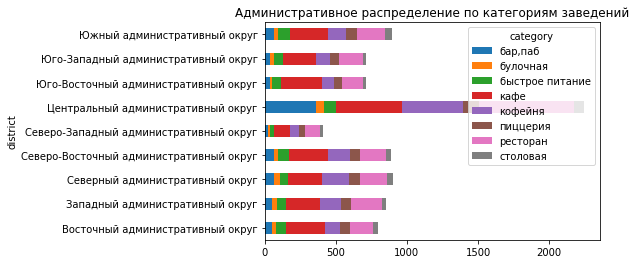

In [51]:
distr_plt = data[["district", 'category']].groupby(['district', 'category']).size().sort_values(ascending=False).unstack('category')
distr_plt.plot(kind='barh', stacked = True, title='Административное распределение по категориям заведений')

### **Средний рейтинг по категориям заведений**

Посмотрим на средний рейтинг заведений в соответствующих категориях.

In [52]:
data[['category', 'rating']].groupby(['category'])['rating'].mean().sort_values(ascending=False)

category
бар,паб            4.387712
пиццерия           4.301264
ресторан           4.290357
кофейня            4.277282
булочная           4.268359
столовая           4.211429
кафе               4.123886
быстрое питание    4.050249
Name: rating, dtype: float64

Посмотрим насколько отличаются усредненные рейтинги в разных типах общепита.

In [53]:
data[['category', 'rating']].groupby(['category'])['rating'].mean().sort_values(ascending=False).describe()

count    8.000000
mean     4.238817
std      0.107302
min      4.050249
25%      4.189543
50%      4.272821
75%      4.293084
max      4.387712
Name: rating, dtype: float64

**Усредненные рейтинги в заведениях разных категорий отличаются незначительно, стандартное отклонени std = 0.10**

### **Средний рейтинг по районам**

Посмотрим на средний рейтинг заведений для каждого района

In [54]:
rating_df = data[['district', 'rating']].groupby(['district'])['rating'].mean().sort_values(ascending=False)
rating_df

district
Центральный административный округ         4.377520
Северный административный округ            4.239778
Северо-Западный административный округ     4.208802
Южный административный округ               4.184417
Западный административный округ            4.181551
Восточный административный округ           4.174185
Юго-Западный административный округ        4.172920
Северо-Восточный административный округ    4.148260
Юго-Восточный административный округ       4.101120
Name: rating, dtype: float64

Визуализируем информацию. Построим фоновую картограмму (хороплет) со средним рейтингом заведений каждого района.

In [55]:
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = '/content/drive/MyDrive/Colab Notebooks/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

### **Все заведения на карте**

Отобразим все заведения датаесета на карте с помощью кластеров средствами библиотеки folium. Дополнительно выведем информацию о типе заведений, их названиях и рейтинге.

In [56]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['category']} {row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data[['name', 'category', 'rating', 'lat', 'lng']].apply(create_clusters, axis=1)

# выводим карту
m

### **Топ-15 улиц**

Найдем топ-15 улиц по количеству расположенных на них заведений.

In [57]:
data["street"].value_counts().head(15)

 проспект Мира             184
 Профсоюзная улица         122
 проспект Вернадского      108
 Ленинский проспект        107
 Ленинградский проспект     95
 Дмитровское шоссе          88
 Каширское шоссе            77
 Варшавское шоссе           76
 Ленинградское шоссе        70
 МКАД                       65
 Люблинская улица           60
 улица Вавилова             55
 Кутузовский проспект       54
 улица Миклухо-Маклая       49
 Пятницкая улица            48
Name: street, dtype: int64

Создадим список топ-15 улиц, по количеству расположенных на них заведений.

In [58]:
top_15_street = data["street"].value_counts().head(15).index
top_15_street

Index([' проспект Мира', ' Профсоюзная улица', ' проспект Вернадского',
       ' Ленинский проспект', ' Ленинградский проспект', ' Дмитровское шоссе',
       ' Каширское шоссе', ' Варшавское шоссе', ' Ленинградское шоссе',
       ' МКАД', ' Люблинская улица', ' улица Вавилова',
       ' Кутузовский проспект', ' улица Миклухо-Маклая', ' Пятницкая улица'],
      dtype='object')

Посмотрим на распределение количества заведений по топ-15 улицам.

In [59]:
data[data['street'].isin(top_15_street)][['category', 'street']].groupby(['street', 'category']).size().unstack('category')

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
street,,,,,,,,
Варшавское шоссе,6.0,NaN,7.0,18.0,14.0,4.0,20.0,7.0
Дмитровское шоссе,6.0,2.0,10.0,23.0,11.0,8.0,24.0,4.0
Каширское шоссе,2.0,NaN,10.0,20.0,16.0,5.0,19.0,5.0
Кутузовский проспект,2.0,1.0,2.0,14.0,13.0,3.0,16.0,3.0
Ленинградский проспект,15.0,4.0,2.0,12.0,25.0,9.0,25.0,3.0
Ленинградское шоссе,5.0,2.0,5.0,13.0,13.0,3.0,26.0,3.0
Ленинский проспект,10.0,3.0,2.0,26.0,23.0,5.0,33.0,5.0
Люблинская улица,5.0,NaN,5.0,26.0,11.0,1.0,10.0,2.0
МКАД,1.0,NaN,9.0,45.0,4.0,NaN,5.0,1.0


Построим визуализацию распределения количества заведений и их категорий по топ-15 улиц г. Москва

<AxesSubplot:title={'center':'Административное распределение по категориям заведений'}, ylabel='street'>

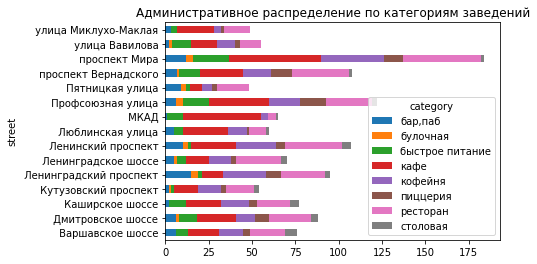

In [60]:
top_15_street_plt = data[data['street'].isin(top_15_street)][['category', 'street']].groupby(['street', 'category']).size().unstack('category')
top_15_street_plt.plot(kind='barh', stacked = True, title='Административное распределение по категориям заведений')

### **Улицы с одним заведением**

Найдем перечень улиц на которых расположено только одно заведение.

In [61]:
one_place_street = data["street"].groupby(data["street"]).count().sort_values()
one_obj = one_place_street[one_place_street == 1].index
one_obj

Index([' 1-й Автозаводский проезд', ' Одинцовская улица',
       ' Октябрьский переулок', ' Ордынский тупик', ' Оренбургская улица',
       ' Орловский переулок', ' Оршанская улица', ' Островная улица',
       ' Новоясеневский тупик', ' Отрадный проезд',
       ...
       ' Андреевский пешеходный мост', ' Верхний Сусальный переулок',
       ' 2-я Рощинская улица', ' 1-й Дербеневский переулок',
       ' Бибиревская улица', ' 3-й Хорошёвский проезд', ' Бобров переулок',
       ' Богословский переулок', ' 4-й Лесной переулок',
       ' 1-й Капотнинский проезд'],
      dtype='object', name='street', length=458)

Информация о заведениях, расположенных на данных улицах 

In [62]:
data[data['street'].isin(one_obj)]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
15,Дом обеда,столовая,"Москва, улица Бусиновская Горка, 2",Северный административный округ,пн-пт 08:30–18:30; сб 10:00–20:00,55.885890,37.493264,4.1,средние,Средний счёт:300–500 ₽,400.0,NaN,0,180.0,улица Бусиновская Горка,False
21,7/12,кафе,"Москва, Прибрежный проезд, 7",Северный административный округ,"ежедневно, 10:00–22:00",55.876805,37.464934,4.5,NaN,NaN,NaN,NaN,0,NaN,Прибрежный проезд,False
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,NaN,парк Левобережный,False
58,Coffeekaldi's,кофейня,"Москва, Угличская улица, 13, стр. 8",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.900316,37.570558,4.1,средние,Средний счёт:500–800 ₽,650.0,NaN,1,NaN,Угличская улица,False
60,Чебуречная история,кофейня,"Москва, ландшафтный заказник Лианозовский",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.899845,37.570488,4.9,NaN,NaN,NaN,NaN,1,NaN,ландшафтный заказник Лианозовский,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8289,Мираж,ресторан,"Москва, улица Шкулёва, 2А",Юго-Восточный административный округ,"пн-пт 11:00–23:00; сб,вс 11:00–00:00",55.693340,37.746231,4.7,NaN,NaN,NaN,NaN,0,90.0,улица Шкулёва,False
8294,WTFcoffee,кофейня,"Москва, улица Артюхиной, 14/8с1",Юго-Восточный административный округ,"ежедневно, 10:00–22:00",55.699044,37.737790,4.4,средние,NaN,NaN,NaN,0,NaN,улица Артюхиной,False
8317,Беседка,кафе,"Москва, Кузьминская улица, 10",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.690691,37.787735,4.1,NaN,NaN,NaN,NaN,1,NaN,Кузьминская улица,False
8379,Лагман Хаус,кафе,"Москва, Новороссийская улица, 14, стр. 2",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.678772,37.759422,4.3,NaN,NaN,NaN,NaN,1,40.0,Новороссийская улица,False


Числовые признаки

In [63]:
data[data['street'].isin(one_obj)][["rating", "seats", 'chain', 'middle_avg_bill', 'middle_coffee_cup']].describe()

,rating,seats,chain,middle_avg_bill,middle_coffee_cup
count,458.000000,156.000000,458.000000,165.000000,24.000000
mean,4.236681,59.115385,0.290393,959.830303,186.166667
std,0.461952,48.274880,0.454440,999.518083,55.544472
min,1.000000,0.000000,0.000000,67.000000,95.000000
25%,4.100000,30.000000,0.000000,325.000000,140.000000
50%,4.300000,45.000000,0.000000,625.000000,177.500000
75%,4.500000,80.000000,1.000000,1250.000000,213.750000
max,5.000000,240.000000,1.000000,7000.000000,320.000000


Категориальные признаки

In [64]:
data[data['street'].isin(one_obj)][['name', 'category', 'district', 'hours', 'price', 'avg_bill', 'is_24/7']].describe(include=["object"])

,name,category,district,hours,price,avg_bill,is_24/7
count,458,458,458,431,182,194,431
unique,403,8,9,178,4,125,2
top,Кафе,кафе,Центральный административный округ,"ежедневно, круглосуточно",средние,Средний счёт:1000–1500 ₽,False
freq,19,160,145,31,120,10,400


Отобразим на карте данные заведения и добавим на карту информацию о среднем рейтинге по административным районам.

In [65]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# загружаем JSON-файл с границами округов Москвы
state_geo = '/content/drive/MyDrive/Colab Notebooks/admin_level_geomap.geojson'

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.5,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['category']} {row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data[data['street'].isin(one_obj)][['name', 'category', 'rating', 'lat', 'lng']].apply(create_clusters, axis=1)

# выводим карту
m

**С учетом визуализации можно сделать вывод о том, что большинство из рассмотреннх заведений (одно заведение на улице) расположены в Центральном административном округе г. Москва, соответственно они имееют более высокий средний рейтинг 4.23 (mean rating) и средний чек 959 руб. (mean middle_avg_bill. Для сравнения у топ-15 популярных сетевых заведений (по количеству заведений в регионе) средний рейтинг 4.14 (mean rating) и средний чек 520 руб. (mean middle_avg_bill)**  	 

### **Средний чек**

Найдем медиану для значений средних чеков (столбец `middle_avg_bill`) по каждому административному округу.

In [66]:
middle_bill = data.groupby(["district"])['middle_avg_bill'].agg('median').sort_values(ascending=False)
middle_bill

district
Западный административный округ            1000.0
Центральный административный округ         1000.0
Северо-Западный административный округ      700.0
Северный административный округ             650.0
Юго-Западный административный округ         600.0
Восточный административный округ            575.0
Северо-Восточный административный округ     500.0
Южный административный округ                500.0
Юго-Восточный административный округ        450.0
Name: middle_avg_bill, dtype: float64

Нанесем на фоновую картограмму (хороплет) медианные значения средних чеков для каждого административного округа. Также нанесем на карту сами заведения, их категории и средний чек.

In [67]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# загружаем JSON-файл с границами округов Москвы
state_geo = '/content/drive/MyDrive/Colab Notebooks/admin_level_geomap.geojson'

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=middle_bill,
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.5,
    legend_name='Медианный чек заведений по районам, руб.',
).add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['category']} {row['name']} {row['middle_avg_bill']} руб.",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data[['name', 'category', 'middle_avg_bill', 'lat', 'lng']].apply(create_clusters, axis=1)

# выводим карту
m

**Медианное значение среднего чека для Центрального административного округа ожидаемо самое высокое (1000 руб.), такое же значение у Западного административного округа. Самое низкое медианное значение среднего чека в  Юго-Восточном административном округе (450 руб.)**

### **Общие выводы**

* Наибольшее число заведений общественного питания г. Москва - кафе (28%), далее идут рестораны (24%) и кофейни (17%).

* Наибольшим количеством посадочных мест располагают рестораны (30%), далее идут кафе (23%) и кофейни (16%). При этом стоит обратить внимание на то, что информация в датасете о количестве посадочных мест указана только для 57% заведений.

* Наибольшее количество в представленных сетевых заведениях - кафе (24%), далее идут рестораны (23%) и кофейни (22%).

* Самым популярным сетевым заведением в г. Москва является кофейня Шоколадница (119 заведений). Из статистических данных обращает на себя внимание низкое значение стандартного отклонения (std = 0.33) для рейтинга этих заведений, при среднем значении (mean) рейтинга 4.14. Топ-15 сетевых заведений представлены в четырех административных округах - Западном, Северном, Центральном и Юго-Западном. Самые популярные заведения по количеству - кофейни (356 заведений).

* Больше всего заведений общественного питания в Центральном административном округе (2242 заведения).

* Усредненные рейтинги в заведениях разных категорий отличаются незначительно, стандартное отклонение std = 0.10.

* Большинство заведений (одно заведение на улице) расположены в Центральном административном округе г. Москва, соответственно они имееют более высокий средний рейтинг 4.23 (mean rating) и средний чек 959 руб. (mean middle_avg_bill. Для сравнения у топ-15 популярных сетевых заведений (по количеству заведений в регионе) средний рейтинг 4.14 (mean rating) и средний чек 520 руб. (mean middle_avg_bill).

* Медианное значение среднего чека для Центрального административного округа ожидаемо самое высокое (1000 руб.), такое же значение у Западного административного округа. Самое низкое медианное значение среднего чека в Юго-Восточном административном округе (450 руб.).


## 4. Детализация исследования: открытие кофейни

Определим количество кофеен в датасете.

In [68]:
data[data['category'] == 'кофейня']['category'].count()

1413

Найдем административный район в котором больше всего заведений данного типа.

In [69]:
data[data['category'] == 'кофейня'].groupby(["district"]).size().sort_values(ascending=False)

district
Центральный административный округ         428
Северный административный округ            193
Северо-Восточный административный округ    159
Западный административный округ            150
Южный административный округ               131
Восточный административный округ           105
Юго-Западный административный округ         96
Юго-Восточный административный округ        89
Северо-Западный административный округ      62
dtype: int64

**Общее количестов кофеен в датасете - 1413, наибольшее количество кофеен расположено в Центральном административном округе (428 кофеен). Особенность их расположения - максимальная близость к человекопотоку (вокзалы, метро, бизнесс-центры и туристические маршруты).**

Определим количество кофеен, работающих круглосуточно.

In [70]:
data['is_24'] = data['hours'].dropna().map(lambda x: 'круглосуточно' in x)

Проверяем

In [71]:
data[['category', "hours","is_24"]][(data['category'] == 'кофейня') & data['is_24'] == True]

,category,hours,is_24
200,кофейня,"ежедневно, круглосуточно",True
971,кофейня,"ежедневно, круглосуточно",True
1047,кофейня,"ежедневно, круглосуточно",True
1214,кофейня,"ежедневно, круглосуточно",True
1291,кофейня,"ежедневно, круглосуточно",True
...,...,...,...
6592,кофейня,"ежедневно, круглосуточно",True
6890,кофейня,"ежедневно, круглосуточно",True
7528,кофейня,"ежедневно, круглосуточно",True
7668,кофейня,"ежедневно, круглосуточно",True


Получили 76 кофеен, работающих круглосуточно, это те же заведения, которые мы находили выше, работающие также в режиме 24/7.

In [72]:
data[data['category'] == 'кофейня'].groupby(['is_24/7']).size().sort_values(ascending=False)

is_24/7
False    1322
True       76
dtype: int64

**В датасете 76 круглосуточных кофеен.**

Определим рейтинги кофеен.

In [76]:
data[['category', 'district', 'rating']][data['category'] == 'кофейня'].describe()

,rating
count,1413.000000
mean,4.277282
std,0.372250
min,1.400000
25%,4.100000
50%,4.300000
75%,4.400000
max,5.000000


**Средний рейтинг у кофеен - 4,28**

Посмотрим на рейтинги кофеен в разрезе по административным округам, по убыванию рейтинга.

In [73]:
rating_coffee_df = data[['district', 'rating']][data['category'] == 'кофейня'].groupby(['district'])['rating'].mean().sort_values(ascending=False)
rating_coffee_df

district
Центральный административный округ         4.336449
Северо-Западный административный округ     4.325806
Северный административный округ            4.291710
Юго-Западный административный округ        4.283333
Восточный административный округ           4.282857
Южный административный округ               4.232824
Юго-Восточный административный округ       4.225843
Северо-Восточный административный округ    4.216981
Западный административный округ            4.195333
Name: rating, dtype: float64

**Лучший рейтинг у кофеен в Центральном административном округе (4.34)**

Посмотрим на медианное значение цены за чашку кофе (столбец `middle_coffee_cup`) в разрезе по административным округам. Соответственно на эту цену стоит ориентироваться при открытии кофейни.

In [88]:
middle_coffe_cup = data[['district', 'middle_coffee_cup']][data['category'] == 'кофейня'].groupby(["district"])['middle_coffee_cup'].agg('median').sort_values(ascending=False)
middle_coffe_cup

district
Юго-Западный административный округ        198.0
Центральный административный округ         190.0
Западный административный округ            189.0
Северо-Западный административный округ     165.0
Северо-Восточный административный округ    162.5
Северный административный округ            159.0
Южный административный округ               150.0
Юго-Восточный административный округ       147.5
Восточный административный округ           135.0
Name: middle_coffee_cup, dtype: float64

Визуализируем информацию. Ненесем на карту все кофейни, построим фоновую картограмму (хороплет) со средней медианной ценой за чашку кофе для каждого района. Также выведем для каждого объекта его название и `middle_coffee_cup`.

In [91]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# загружаем JSON-файл с границами округов Москвы
state_geo = '/content/drive/MyDrive/Colab Notebooks/admin_level_geomap.geojson'

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=middle_coffe_cup,
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.5,
    legend_name='Медианная стоимость чашки кофе по районам, руб.',
).add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['category']} {row['name']} {row['middle_coffee_cup']} руб.",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data[['name', 'category', 'middle_coffee_cup', 'lat', 'lng']][data['category'] == 'кофейня'].apply(create_clusters, axis=1)

# выводим карту
m

### **Итоговые рекомендации**

Открытие новой кофейни целесообразно осуществить в Центральном административном округе, как наиболее привлекательном с точки зрения потребительской способности.

## 5. Презентация

Презентация: <ссылка на облачное хранилище с презентацией>